# Table of contents

[Context](#context)

[Download the latest data](#download)

[The purposes of this project](#purpose)

[Main Findings](#find)

[Importing packages and reading file](#package)

[Data wrangling](#data)

[Exploratory data analysis](#eda)

[Model estimation and prediction](#model)

- [Data Preparation for modeling](#modeling)
- [Estimation](#linear)
- [Prediction](#predict)
- [Hyperparameter tuning](#hypter)

[Model selection and final results](#result)

# Context <a id="context"></a>

How is Airbnb really being used in and affecting the neighbourhoods of your city? Airbnb claims to be part of the 'sharing economy' and disrupting the hotel industry. However, data shows that the majority of Airbnb listings in most cities are entire homes, many of which are rented all year round - disrupting housing and communities.

(source: https://insideairbnb.com/)

# Download the latest data <a id="download"></a>
https://insideairbnb.com/get-the-data/
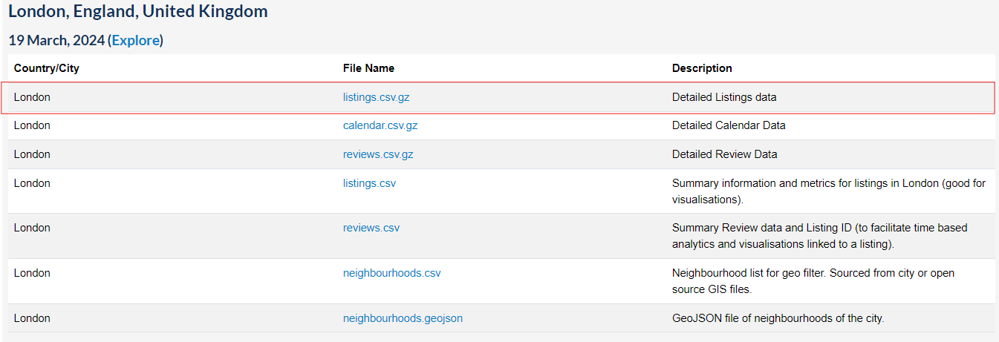

# The purposes of this project: <a id="purpose"></a>
- *To gain insights into listings and identify the optimal model for price prediction.*

# Main Findings: <a id="find"></a>
- Airbnb in London consists of around 55,035 hosts and 90,848 listings.
- The top ten hosts individually have more than 150 listings.
- The most popular area is Westminster, accounting for more than 11% of the listings.
- At least 95% of the market is occupied by rooms with prices lower than 500 pounds per night.
- The pricing settings are similar between `Entire home/apt` and `Hotel room`, as well as between `Private room` and `Shared room`.
- In `Entire home/apt`, only 5% of the listings require a minimum stay of more than 20 nights. 
- The services offered are primarily designed for short-term rental arrangements.
- Over the past 12 months, the average minimum income was about 3172 pounds.
- The best model for price prediction is the Random Forest, and the model explains about 63% of the variation in price.

# Import packages and read file <a id="package"></a>

In [1]:
# Import necessary packages
import time
import warnings
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly
import plotly.express as px
import scipy.stats as stats
import seaborn as sns
import statsmodels.api as sm

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import RobustScaler
from sklearn import metrics
from sklearn.linear_model import LinearRegression, ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from xgboost import XGBRegressor

warnings.filterwarnings("ignore")
plotly.offline.init_notebook_mode()

In [2]:
# Read the csv file downloaded from the website
raw_data = pd.read_csv("listings.csv")

In [3]:
# Summary of the raw data
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90852 entries, 0 to 90851
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            90852 non-null  int64  
 1   listing_url                                   90852 non-null  object 
 2   scrape_id                                     90852 non-null  int64  
 3   last_scraped                                  90852 non-null  object 
 4   source                                        90852 non-null  object 
 5   name                                          90852 non-null  object 
 6   description                                   87851 non-null  object 
 7   neighborhood_overview                         47521 non-null  object 
 8   picture_url                                   90842 non-null  object 
 9   host_id                                       90852 non-null 

# Data wrangling <a id="data"></a>

Select variables which are similar to the kaggle dataset

https://www.kaggle.com/datasets/dgomonov/new-york-city-airbnb-open-data/data

- id: Airbnb's unique identifier for the listing.
- name: Name of the listing.
- host_id: Airbnb's unique identifier for the host.
- host_name: Name of the host.
- calculated_host_listings_count: The number of listings the host has.
- neighbourhood_cleansed: The neighbourhood as geocoded using the latitude and longitude against neighborhoods as defined by open or public digital shapefiles.
- latitude: Uses the World Geodetic System (WGS84) projection for latitude and longitude.
- longitude: Uses the World Geodetic System (WGS84) projection for latitude and longitude.
- room_type: Entire place, Private room, Shared room, Hotel room.
- price: daily price in local currency.
- minimum_nights: minimum number of night stay for the listing.
- maximum_nights: maximum number of night stay for the listing.
- availability_365: avaliability_x. The availability of the listing x days in the future as determined by the calendar. Note a listing may not be available because it has been booked by a guest or blocked by the host.
- number_of_reviews: The number of reviews the listing has.
- number_of_reviews_ltm: The number of reviews the listing has (in the last 12 months).
- reviews_per_month: The average number of reviews per month the listing has over the lifetime of the listing.
- first_review: The date of the first/oldest review.

In [4]:
# Select variables and save them for further analysis
data = raw_data.loc[:,
    [
        "id",
        "name",
        "host_id",
        "host_name",
        "calculated_host_listings_count",
        "neighbourhood_cleansed",
        "latitude",
        "longitude",
        "room_type",
        "price",
        "minimum_nights",
        "maximum_nights",
        "availability_365",
        "number_of_reviews",
        "number_of_reviews_ltm",
        "reviews_per_month",
        "first_review",
    ],
].copy()

In [5]:
# Data overview
data.head()

,id,name,host_id,host_name,calculated_host_listings_count,neighbourhood_cleansed,latitude,longitude,room_type,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,number_of_reviews_ltm,reviews_per_month,first_review
0,312761,Spacious Central London Apartment by Hoxton Sq...,1608226,Pippa,1,Hackney,51.52704,-0.08129,Entire home/apt,$160.00,9,180,81,122,26,0.86,2012-07-12
1,13913,Holiday London DB Room Let-on going,54730,Alina,3,Islington,51.56861,-0.11270,Private room,$65.00,1,29,351,41,1,0.25,2010-08-18
2,15400,Bright Chelsea Apartment. Chelsea!,60302,Philippa,1,Kensington and Chelsea,51.48780,-0.16813,Entire home/apt,$120.00,4,30,88,94,2,0.54,2009-12-21
3,159736,A double Room 5mins from King's College Hospital,766056,Trevor,4,Lambeth,51.46788,-0.09993,Private room,$65.00,4,96,268,96,1,0.62,2011-07-16
4,165336,Charming Flat in Notting Hill,761400,Nathan,1,Kensington and Chelsea,51.51735,-0.21076,Entire home/apt,$100.00,1,14,3,237,25,1.57,2011-10-16


In [6]:
# Show the size of the data and check duplicate rows
[rowCount, coloumCount] = data.shape
print(f"the number of rows: {rowCount}")
print(f"the number of columns: {coloumCount}")
print(f"the number of duplicate rows: {data.duplicated().sum()}")

the number of rows: 90852
the number of columns: 17
the number of duplicate rows: 0


In [7]:
# Check if the `calculated_host_listings_count` is equal to the count of distinct `host_id`
ds1 = data["host_id"].value_counts().reset_index()
ds2 = (
    data.groupby("host_id")
    .aggregate({"calculated_host_listings_count": "first"})
    .sort_values(by="calculated_host_listings_count", ascending=False)
    .reset_index()
)
display(ds1.head())
display(ds2.head())
ds3 = pd.merge(ds1, ds2, on="host_id", how="outer")
ds3["diff"] = ds3["count"] - ds3["calculated_host_listings_count"]
print(f"the difference numbers: {ds3['diff'].sum(skipna=False)}")

,host_id,count
0,129230780,558
1,314162972,412
2,33889201,378
3,1432477,312
4,28820321,268


,host_id,calculated_host_listings_count
0,129230780,558
1,314162972,412
2,33889201,378
3,1432477,312
4,28820321,268


the difference numbers: 0


*<u>Main Findings:</u>*
- The `calculated_host_listings_count` is equal to the count of distinct `host_id` 
- Upon examination, no apparent errors were identified.

In [8]:
# Count the missing values and calculate the percentage
missingDetail = pd.DataFrame({"missing_count": data.isna().sum()})
missingDetail["missing_%"] = (missingDetail["missing_count"] / rowCount) * 100
print(missingDetail)

                                missing_count  missing_%
id                                          0   0.000000
name                                        0   0.000000
host_id                                     0   0.000000
host_name                                   5   0.005503
calculated_host_listings_count              0   0.000000
neighbourhood_cleansed                      0   0.000000
latitude                                    0   0.000000
longitude                                   0   0.000000
room_type                                   0   0.000000
price                                   32967  36.286488
minimum_nights                              0   0.000000
maximum_nights                              0   0.000000
availability_365                            0   0.000000
number_of_reviews                           0   0.000000
number_of_reviews_ltm                       0   0.000000
reviews_per_month                       24983  27.498569
first_review                   

*<u>Main Findings:</u>*
- There are about 36% of missing values in the variable `price`.
- About 27% of listings do not have `first_review` and `reviews_per_month`.
- It is worth to explore more on these variables.


In [9]:
# Explore missing values in `price`
data[data["price"].isna()]

,id,name,host_id,host_name,calculated_host_listings_count,neighbourhood_cleansed,latitude,longitude,room_type,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,number_of_reviews_ltm,reviews_per_month,first_review
5,313710,Pretty Home Kensal Green NW10 1 bed,1612623,Alex,1,Brent,51.533470,-0.232920,Entire home/apt,NaN,2,14,0,10,0,0.07,2012-05-01
6,168359,Stunning 2 Bed Apartment in Elephant & Castle,648725,Michele,1,Southwark,51.491850,-0.088230,Entire home/apt,NaN,2,1125,0,9,0,0.06,2011-07-23
8,24328,"Battersea live/work artist house, garden communal",41759,Joe,1,Wandsworth,51.470720,-0.162660,Entire home/apt,NaN,2,1125,0,94,0,0.58,2010-11-15
11,170702,A Double Room with River Views,814004,Marie,1,Tower Hamlets,51.496860,-0.026270,Private room,NaN,3,365,0,135,0,0.88,2011-08-01
13,314985,"Room in Artistic house, nr Olympics",1617885,Roger,1,Newham,51.526260,0.029040,Private room,NaN,2,7,0,6,0,0.05,2013-10-13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87602,1091820475825413494,Fantastic 2 bedroom apartment in Surbiton,9063235,Executive Roomspace,101,Kingston upon Thames,51.390064,-0.302473,Entire home/apt,NaN,1,365,26,0,0,NaN,NaN
87636,1093296855207837501,Cozy and spacious flat,104544556,Angie,1,Lambeth,51.445472,-0.123503,Entire home/apt,NaN,3,365,127,0,0,NaN,NaN
88004,1095441435477010989,Magical townhouse getaway in London,33561493,Leah,1,Westminster,51.526263,-0.203725,Entire home/apt,NaN,2,365,7,3,3,3.00,2024-03-09
88090,1096451917769415868,Jochebed House|Brixton Centre|Spacious|LongTerm,229912595,Nicole,5,Lambeth,51.455206,-0.116343,Entire home/apt,NaN,3,365,170,0,0,NaN,NaN


*<u>Main Findings:</u>*
- From the above data,  it can be seen that the data provide useful information even if `prices` are missing.
- At the stage of EDA, they should not be removed.

In [10]:
# Explore missing values in `first_review` (`reviews_per_month`)
data[data["first_review"].isna()]

,id,name,host_id,host_name,calculated_host_listings_count,neighbourhood_cleansed,latitude,longitude,room_type,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,number_of_reviews_ltm,reviews_per_month,first_review
9,170524,STUNNING APT IN ST JAMES,194769,D,4,Westminster,51.506120,-0.140290,Entire home/apt,"$1,300.00",14,730,365,0,0,NaN,NaN
35,318986,Central London flat for Olympics,1637212,Apprameya,1,Kensington and Chelsea,51.491130,-0.194820,Entire home/apt,NaN,7,21,0,0,0,NaN,NaN
45,42692,Fabulous flat w garden and bkfst!,186510,Shelley,1,Hammersmith and Fulham,51.508220,-0.215620,Private room,NaN,1,14,0,0,0,NaN,NaN
49,44384,DOUBLE ROOM IN A PENTHOUSE APARTMEN,194769,D,4,Barnet,51.597900,-0.243270,Private room,$43.00,30,365,365,0,0,NaN,NaN
56,324055,worth to stay.you will never regret,1664001,Ganesan,1,Newham,51.553110,0.022730,Private room,NaN,150,365,0,0,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90847,1115272743905612628,Primrose Hill Studio #25,565833376,Henna,48,Bexley,51.502721,0.147342,Entire home/apt,$225.00,1,365,268,0,0,NaN,NaN
90848,1115272767893608505,Primrose Hill Studio #27,565833376,Henna,48,Bexley,51.504134,0.148848,Entire home/apt,$225.00,1,365,268,0,0,NaN,NaN
90849,1115285644506865913,Quad Bedroom with External Bathroom,444801189,The Chapter Hotels,33,Westminster,51.506404,-0.148199,Private room,$314.00,1,365,363,0,0,NaN,NaN
90850,1115338006572763275,Grosvenor Collection,514234035,Joe,52,Westminster,51.513649,-0.161906,Entire home/apt,$610.00,1,45,347,0,0,NaN,NaN


*<u>Main Findings:</u>*
- The data provide useful information even if `first_review` and `reviews_per_month` are missing.
- There may be missing values because some customers do not leave any reviews on the listings. 
- At the stage of EDA, they should not be removed.

In [11]:
# Explore missing values in `host_name`
data[data["host_name"].isna()]

,id,name,host_id,host_name,calculated_host_listings_count,neighbourhood_cleansed,latitude,longitude,room_type,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,number_of_reviews_ltm,reviews_per_month,first_review
3927,5811550,large room in Shoreditch,8317501,NaN,1,Tower Hamlets,51.52512,-0.06566,Private room,NaN,1,1125,0,0,0,NaN,NaN
5081,7007873,Victoria / Pimlico,22047056,NaN,1,Westminster,51.49459,-0.13414,Private room,NaN,8,1125,0,0,0,NaN,NaN
5688,7595146,Nice room in near Canary wharf,39828462,NaN,1,Tower Hamlets,51.48730,-0.01428,Private room,NaN,1,1125,0,0,0,NaN,NaN
6220,8149344,LUXURIOUS SUITE IN HISTORIC HOUSE,43023101,NaN,1,Waltham Forest,51.63272,0.00607,Private room,NaN,7,345,0,0,0,NaN,NaN
6495,8511150,large room in camden,44815642,NaN,1,Camden,51.53744,-0.13965,Private room,NaN,1,1125,0,0,0,NaN,NaN


*<u>Main Findings:</u>*
- There are 5 missing values simultaneously presenting in `host_name` ,`price`,`reviews_per_month`,and `first_review`.
- At the stage of EDA, these missing values will not affect the analysis and should not be removed.

In [12]:
# Data summary
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90852 entries, 0 to 90851
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              90852 non-null  int64  
 1   name                            90852 non-null  object 
 2   host_id                         90852 non-null  int64  
 3   host_name                       90847 non-null  object 
 4   calculated_host_listings_count  90852 non-null  int64  
 5   neighbourhood_cleansed          90852 non-null  object 
 6   latitude                        90852 non-null  float64
 7   longitude                       90852 non-null  float64
 8   room_type                       90852 non-null  object 
 9   price                           57885 non-null  object 
 10  minimum_nights                  90852 non-null  int64  
 11  maximum_nights                  90852 non-null  int64  
 12  availability_365                

In [13]:
# Convert data type of `price` to float and `first_review` to datetime
data["price"] = data["price"].str.replace("[^-.0-9]", "", regex=True).astype(float)
data["first_review"] = pd.to_datetime(data["first_review"])
print(f"data type of price: {data['price'].dtypes}")
print(f"data type of first_review: {data['first_review'].dtypes}")

data type of price: float64
data type of first_review: datetime64[ns]


In [14]:
# Descriptive statistics on meaningful variables
data[
    [
        "calculated_host_listings_count",
        "price",
        "minimum_nights",
        "maximum_nights",
        "availability_365",
        "number_of_reviews",
        "number_of_reviews_ltm",
        "reviews_per_month",
    ]
].describe()

,calculated_host_listings_count,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,number_of_reviews_ltm,reviews_per_month
count,90852.000000,57885.000000,90852.000000,9.085200e+04,90852.000000,90852.00000,90852.000000,65869.000000
mean,18.495927,180.275944,5.418747,6.486027e+03,124.256164,17.81132,5.488531,0.905957
std,65.205497,434.505248,22.099520,1.741865e+06,130.755632,42.88319,11.656508,1.195357
min,1.000000,0.000000,1.000000,1.000000e+00,0.000000,0.00000,0.000000,0.010000
25%,1.000000,74.000000,1.000000,6.000000e+01,0.000000,0.00000,0.000000,0.160000
50%,2.000000,125.000000,2.000000,3.650000e+02,80.000000,4.00000,1.000000,0.490000
75%,6.000000,200.000000,4.000000,1.125000e+03,249.000000,16.00000,6.000000,1.140000
max,558.000000,53588.000000,1125.000000,5.248556e+08,365.000000,1672.00000,475.000000,32.260000


*<u>Main Findings:</u>*
- The minimum price is 0, and the highest number of maximum_nights exceeds 524 million, which necessitates further investigation.
- The data are heavily skewed.

In [15]:
# Investigate the variable `price`
data.sort_values(by="price", ascending=True).head()

,id,name,host_id,host_name,calculated_host_listings_count,neighbourhood_cleansed,latitude,longitude,room_type,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,number_of_reviews_ltm,reviews_per_month,first_review
40878,49765360,Private room by Spitalfields Market,3010498,Michael,2,Tower Hamlets,51.515915,-0.073669,Private room,0.0,1,6,6,2,2,0.30,2023-09-06
35860,41155199,Large private room in Shoreditch apartment,3010498,Michael,2,Tower Hamlets,51.525840,-0.068670,Private room,1.0,30,1125,351,1,0,0.02,2020-08-15
87652,1093343136399687490,Double Bedroom in Luxury Apartment,100672427,Adam,1,Lambeth,51.474950,-0.108340,Private room,8.0,2,365,178,5,5,5.00,2024-02-24
72031,959968164600589433,Luxury Urban Cabin retreat,104056862,Cyprian,2,Sutton,51.352750,-0.176380,Entire home/apt,9.0,2,21,0,0,0,NaN,NaT
66713,914539486714415414,Comfy room in central London,519672586,Natalia,1,Islington,51.526608,-0.103219,Private room,9.0,2,6,27,38,38,4.10,2023-06-18


*<u>Main Findings:</u>*
- There is only 1 room with a 0 price, which may suggest that the room is conditional on some unknown factors for being offered for free.
- The same host also offers a room at a cheaper price.
- Therefore, it is not necessary to remove the data at this stage.

In [16]:
# Investigate the variable `maximum_nights`
data.sort_values(by="maximum_nights", ascending=False).head(5)

,id,name,host_id,host_name,calculated_host_listings_count,neighbourhood_cleansed,latitude,longitude,room_type,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,number_of_reviews_ltm,reviews_per_month,first_review
6074,7878442,Small single bedroom,41528394,Michael,3,Merton,51.40544,-0.20928,Private room,28.0,1,524855552,309,281,45,2.72,2015-09-27
12992,15695715,"lovely double room in house, honor oak/foresthill",25655886,Josh,1,Lewisham,51.44673,-0.05076,Private room,NaN,1,10000000,0,1,0,0.01,2016-11-15
15131,17877540,London Bridge Single Room 170pw,89593642,珀,1,Southwark,51.50335,-0.09031,Private room,NaN,9,9000000,0,0,0,NaN,NaT
173,270600,Patio Apartment in London (Twickenham),1416605,Emma,2,Richmond upon Thames,51.44311,-0.33245,Entire home/apt,80.0,4,9011,158,79,9,0.61,2013-07-17
4649,6622730,Lovely DOUBLE ROOM in Hackney!,20418398,Silvia,3,Hackney,51.55226,-0.06549,Private room,NaN,3,2000,0,11,0,0.10,2015-06-08


*<u>Main Findings:</u>*
- There are 4 rooms that can be lived in for more than 20 years. 
- Compared to others, the 'maximum_nights' values in the first 4 rows of the data seem to be unusual.
- These 4 rows will be removed.

In [17]:
# Before removing the abnormal data, it is necessary to recalculate the values for the variable `calculated_host_listings_count`.
recalculated = (
    data.loc[data["maximum_nights"] > 9000, "host_id"].value_counts().reset_index()
)

for id, val in zip(recalculated["host_id"], recalculated["count"]):
    data.loc[data["host_id"] == id, "calculated_host_listings_count"] = (
        data.loc[data["host_id"] == id, "calculated_host_listings_count"] - val
    )

# Remove the abnormal data
data = data[data["maximum_nights"] < 9000].reset_index(drop=True)
data.sort_values(by="maximum_nights", ascending=False).head()

,id,name,host_id,host_name,calculated_host_listings_count,neighbourhood_cleansed,latitude,longitude,room_type,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,number_of_reviews_ltm,reviews_per_month,first_review
4648,6622730,Lovely DOUBLE ROOM in Hackney!,20418398,Silvia,3,Hackney,51.55226,-0.06549,Private room,NaN,3,2000,0,11,0,0.10,2015-06-08
6248,8168705,Romantic Double room in Arty flat in Hackney,20418398,Silvia,3,Hackney,51.55353,-0.06593,Private room,NaN,3,2000,0,12,0,0.12,2015-09-14
1986,2836575,Beautiful room in period house,13709501,Faith And Tony,1,Islington,51.56041,-0.09957,Private room,48.0,2,1444,1,58,0,0.49,2014-07-01
28787,32293161,Clarkson Double room 3,31870202,Juhel,17,Tower Hamlets,51.52794,-0.06004,Private room,NaN,1,1125,0,40,0,0.64,2019-02-14
28791,32154993,Nice flat all to yourselves - 10 min walk to tube,27992377,Paul,1,Waltham Forest,51.56412,-0.01452,Entire home/apt,NaN,5,1125,0,8,0,0.13,2019-04-27


In [18]:
# Cross-check the data
print(f"observations: {len(data['host_id'])}")
print(f"observations: {data['host_id'].value_counts().sum()}")
obsCheck = (
    data.groupby("host_id")
    .aggregate({"calculated_host_listings_count": "first"})
    .sort_values(by="calculated_host_listings_count", ascending=False)
    .reset_index()
)
print(f"observations: {sum(obsCheck.calculated_host_listings_count)}")

observations: 90848
observations: 90848
observations: 90848


# Exploratory data analysis <a id="eda"></a>

In [19]:
# Data summary
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90848 entries, 0 to 90847
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              90848 non-null  int64         
 1   name                            90848 non-null  object        
 2   host_id                         90848 non-null  int64         
 3   host_name                       90843 non-null  object        
 4   calculated_host_listings_count  90848 non-null  int64         
 5   neighbourhood_cleansed          90848 non-null  object        
 6   latitude                        90848 non-null  float64       
 7   longitude                       90848 non-null  float64       
 8   room_type                       90848 non-null  object        
 9   price                           57883 non-null  float64       
 10  minimum_nights                  90848 non-null  int64         
 11  ma

In [20]:
# Locations overview
fig = px.density_mapbox(
    data,
    lat="latitude",
    lon="longitude",
    hover_name="name",
    hover_data="price",
    radius=2,
    color_continuous_scale=[
        [0.0, "green"],
        [0.25, "yellow"],
        [0.5, "blue"],
        [0.75, "purple"],
        [1, "red"],
    ],
    opacity=0.5,
    width=800,
    height=600,
)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

*<u>Main Findings:</u>*
- The Airbnb services cover most areas within London.

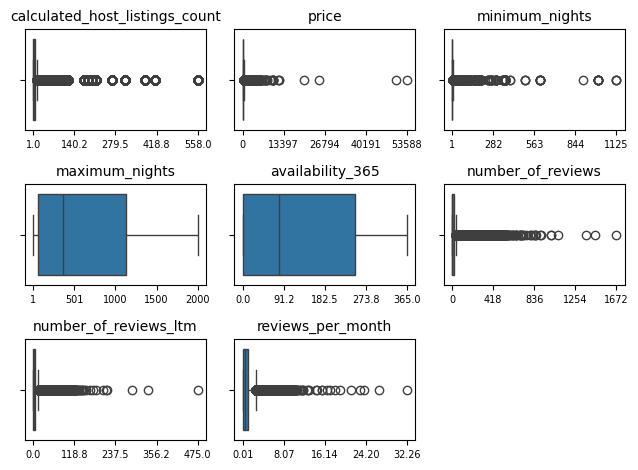

In [21]:
# Boxplot on meaningful variables
numericVariables = [
    "calculated_host_listings_count",
    "price",
    "minimum_nights",
    "maximum_nights",
    "availability_365",
    "number_of_reviews",
    "number_of_reviews_ltm",
    "reviews_per_month",
]
numericData = data[numericVariables].copy()
[fig, axes] = plt.subplots(3, 3)
for val, axe in zip(numericVariables, axes.flat):
    sns.boxplot(ax=axe, data=numericData, x=val)
    axe.set_title(val, fontsize=10)
    axe.set_xlabel("")
    axe.set_xticks(np.linspace(min(numericData[val]), max(numericData[val]), 5))
    axe.tick_params(axis="both", labelsize=7)
axes[2, 2].axis("off")
fig.tight_layout()

*<u>Main Findings</u>:*
- It is obvious that the data are heavily skewed.
- A host may have many listings.
- Some rooms can be very expensive.
- Some rooms are quite popular, while others are not.

In [22]:
# Explore the room types
roomCount = data["room_type"].value_counts().reset_index()
fig = px.pie(roomCount, values="count", names="room_type")
fig.show()

*<u>Main Findings:</u>*
- Airbnb listings are primarily composed of entire homes or apartments, as well as private rooms.

In [23]:
# Explore the number of single and multi-listings
print(
    f"There are about {data['host_id'].nunique()} hosts and {len(data['host_id'])} listings in the market."
)
listCount = data["host_id"].value_counts()
print(f"Multi-listings: {listCount[listCount>1].sum()}")
print(f"Single-listings: {listCount[listCount==1].sum()}")

# Explore the number of listings among the top ten hosts
topHosts = (
    data.groupby("host_id")
    .aggregate({"calculated_host_listings_count": "first"})
    .sort_values(by="calculated_host_listings_count", ascending=False)
    .head(10)
    .reset_index()
)
topHosts["calculated_host_listings_count%"] = (
    topHosts["calculated_host_listings_count"] / len(data["host_id"]) * 100
)

display(topHosts)

# Explore the number of listings among the top ten areas
topAreas = data["neighbourhood_cleansed"].value_counts().head(10).reset_index()
topAreas["count%"] = topAreas["count"] / len(data["host_id"]) * 100
display(topAreas)

There are about 55035 hosts and 90848 listings in the market.
Multi-listings: 46173
Single-listings: 44675


,host_id,calculated_host_listings_count,calculated_host_listings_count%
0,129230780,558,0.614213
1,314162972,412,0.453505
2,33889201,378,0.416080
3,1432477,312,0.343431
4,28820321,268,0.294998
5,258154594,212,0.233357
6,48165024,201,0.221249
7,156158778,201,0.221249
8,269308503,188,0.206939
9,439074505,174,0.191529


,neighbourhood_cleansed,count,count%
0,Westminster,10246,11.278179
1,Tower Hamlets,7256,7.986967
2,Hackney,6279,6.911545
3,Camden,5948,6.547200
4,Kensington and Chelsea,5944,6.542797
5,Southwark,5083,5.595060
6,Lambeth,4900,5.393625
7,Islington,4873,5.363905
8,Wandsworth,4681,5.152563
9,Hammersmith and Fulham,3897,4.289583


*<u>Main Findings:</u>*
- Airbnb in London consists of around 55,035 hosts and 90,848 listings.
- Approximately half of the hosts possess more than one listing.
- The top ten hosts individually have more than 150 listings.
- The most popular area is Westminster, accounting for more than 11% of the listings.

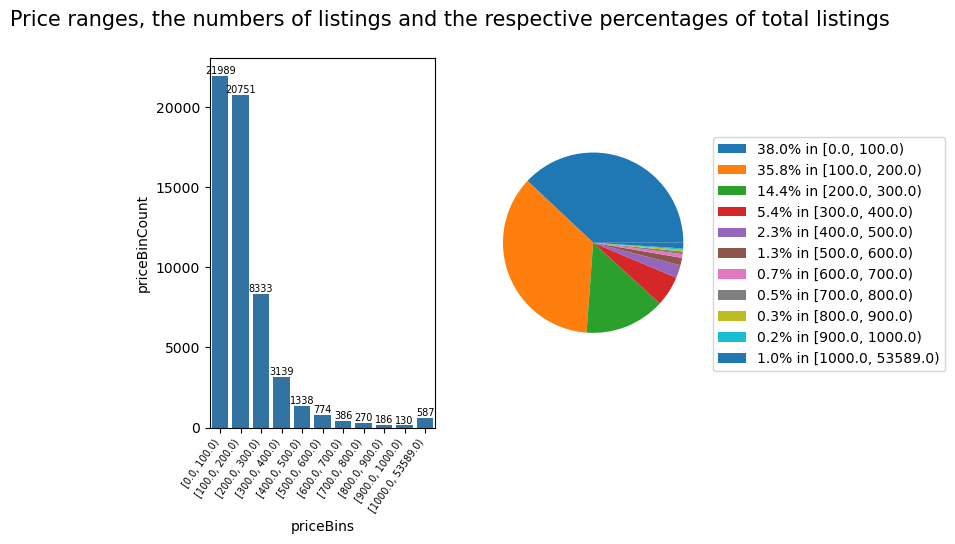

In [24]:
# Explore price ranges and the number of listings
bins = np.arange(0, 1001, 100)
bins = np.ceil(np.append(bins, max(data.price) + 1))
data["priceBins"] = pd.cut(data["price"], bins, right=False)
priceStat = (
    data.groupby("priceBins")
    .aggregate(priceBinCount=("priceBins", "count"))
    .reset_index()
)
priceStat["priceBinCount%"] = priceStat["priceBinCount"] / sum(priceStat["priceBinCount"])

# Visualize price ranges and the number of listings
[fig, axes] = plt.subplots(1, 2)

ax = sns.barplot(ax=axes[0], data=priceStat, x="priceBins", y="priceBinCount")
ax.bar_label(ax.containers[0], fontsize=7)
axes[0].tick_params(axis="x", rotation=55, labelsize=7)

theLegend = (
    np.round(priceStat["priceBinCount%"] * 100, 1).astype(str)
    + "% in "
    + priceStat["priceBins"].astype(str)
)
axes[1].pie(priceStat["priceBinCount"])
axes[1].legend(theLegend, bbox_to_anchor=(1, 1))

plt.sca(axes[0])
plt.xticks(ha="right")
fig.suptitle(
    "Price ranges, the numbers of listings and the respective percentages of total listings",
    ha="center",
    fontsize=15,
)
plt.show()

*<u>Main Findings:</u>*
- At least 95% of the market is occupied by rooms with prices lower than 500 pounds per night.
- It is worth mentioning that the luxury market, with prices beyond 1000 pounds, has about 1% market share.

In [25]:
# locations of those luxury rooms
data1000 = data.loc[data["price"] >= 1000, ["price", "name", "latitude", "longitude"]]
fig = px.scatter_mapbox(
    data1000,
    lat="latitude",
    lon="longitude",
    hover_name="name",
    hover_data="price",
    width=800,
    height=600,
)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

*<u>Main Findings:</u>*
- The luxury rooms are spread across a wide range of locations in London.

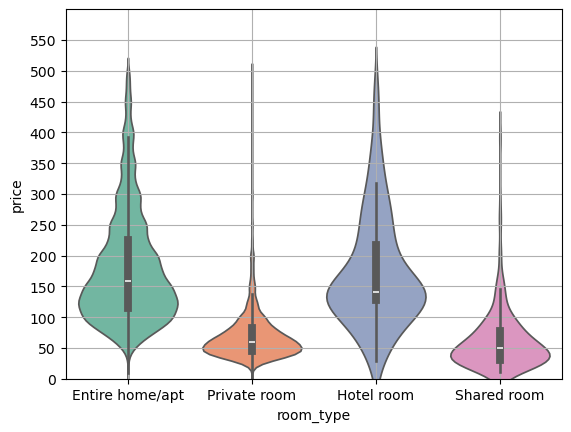

In [26]:
# Explore price ranges [0,500) and the room types
price500 = data.loc[data["price"] < 500, ["room_type", "price"]]
sns.violinplot(data=price500, x="room_type", y="price", palette="Set2")
plt.yticks(np.arange(0, 600, 50))
plt.ylim(0, 600)
plt.grid()
plt.show()

In [27]:
# Conduct t-test
groupPrice = data.pivot(columns=["room_type"], values="price")

print("t-test for the means of 'Entire home/apt' and 'Hotel room' :")
print(
    stats.ttest_ind(
        a=groupPrice["Entire home/apt"],
        b=groupPrice["Hotel room"],
        equal_var=False,
        nan_policy="omit",
    )
)

print("")

print("t-test for the means of 'Private room' and 'Shared room' :")
print(
    stats.ttest_ind(
        a=groupPrice["Private room"],
        b=groupPrice["Shared room"],
        equal_var=False,
        nan_policy="omit",
    )
)

print("")

print("t-test for the means of 'Private room' and 'Entire home/apt' :")
print(
    stats.ttest_ind(
        a=groupPrice["Private room"],
        b=groupPrice["Entire home/apt"],
        alternative="less",
        equal_var=False,
        nan_policy="omit",
    )
)

t-test for the means of 'Entire home/apt' and 'Hotel room' :
TtestResult(statistic=0.2684999449397016, pvalue=0.7887985760650547, df=114.28703319994048)

t-test for the means of 'Private room' and 'Shared room' :
TtestResult(statistic=-1.7477038883721987, pvalue=0.08154561337272741, df=297.90297671231235)

t-test for the means of 'Private room' and 'Entire home/apt' :
TtestResult(statistic=-35.48614166830611, pvalue=2.0250237641758515e-271, df=35836.973693694126)


*<u>Main Findings:</u>*
- The pricing settings are similar between `Entire home/apt` and `Hotel room`, as well as between `Private room` and `Shared room`.
- The prices of `Private room` are significantly less than those of `Entire home/apt`.

,room_type:minimum_nights,count,mean,std,min,5%,25%,50%,75%,95%,max
0,Entire home/apt,57260.0,5.968530,19.793913,1.0,1.0,2.0,3.0,4.0,20.00,1124.0
1,Hotel room,181.0,2.077348,3.163083,1.0,1.0,1.0,1.0,3.0,3.00,30.0
2,Private room,32948.0,4.493626,25.572087,1.0,1.0,1.0,2.0,3.0,11.65,1125.0
3,Shared room,459.0,4.572985,27.318128,1.0,1.0,1.0,1.0,2.0,7.10,365.0


,room_type:maximum_nights,count,mean,std,min,5%,25%,50%,75%,95%,max
0,Entire home/apt,57260.0,510.980335,436.777168,1.0,14.0,90.0,365.0,1125.0,1125.0,1125.0
1,Hotel room,181.0,819.453039,469.031039,7.0,30.0,91.0,1125.0,1125.0,1125.0,1125.0
2,Private room,32948.0,477.976144,466.183141,1.0,6.0,30.0,365.0,1125.0,1125.0,2000.0
3,Shared room,459.0,541.405229,484.904422,1.0,3.0,26.0,365.0,1125.0,1125.0,1125.0


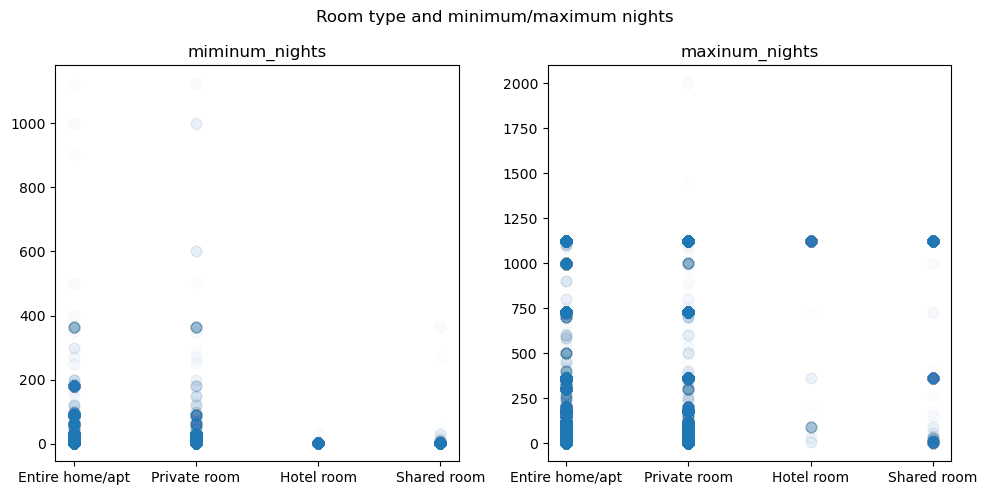

In [28]:
# Descriptive statistics on minimum_nights and maximum_nights
minimum_nights = (
    data.groupby("room_type")["minimum_nights"]
    .describe(percentiles=[0.05, 0.25, 0.50, 0.75, 0.95])
    .reset_index()
)
minimum_nights.rename(columns={"room_type": "room_type:minimum_nights"}, inplace=True)

maximum_nights = (
    data.groupby("room_type")["maximum_nights"]
    .describe(percentiles=[0.05, 0.25, 0.50, 0.75, 0.95])
    .reset_index()
)
maximum_nights.rename(columns={"room_type": "room_type:maximum_nights"}, inplace=True)

display(minimum_nights)
display(maximum_nights)

# Visualize room type and minimum/maximum nights
[fig, axes] = plt.subplots(1, 2, figsize=(10, 5))
axes[0].scatter(data=data, x="room_type", y="minimum_nights", s=60, alpha=0.01)
axes[0].set_title("miminum_nights")
axes[1].scatter(data=data, x="room_type", y="maximum_nights", s=60, alpha=0.01)
axes[1].set_title("maxinum_nights")

fig.suptitle("Room type and minimum/maximum nights")
fig.tight_layout()

*<u>Main Findings:</u>*
- The fluctuations in both `minimum_nights` and `maximum_nights` are large.
- `Entire home/apt` and `Private room` are similar in terms of minimum or maximum number of nights stay.
    - Only 5% of `minimum_nights` are greater than 20 in `Entire home/apt` , and 11 in `Private room`.
- The services offered are primarily designed for short-term rental arrangements.
- At least 50% of the `Hotel rooms` have a `maximum_nights` value greater than 1125.
    - Compared to other rental services, hotel rooms are more likely to cater to guests seeking longer-term rental options.
    - Individuals traveling for business or other purposes may prefer to stay in a hotel room as hotel rooms provide a level of service and hospitality associated with traditional hotels.

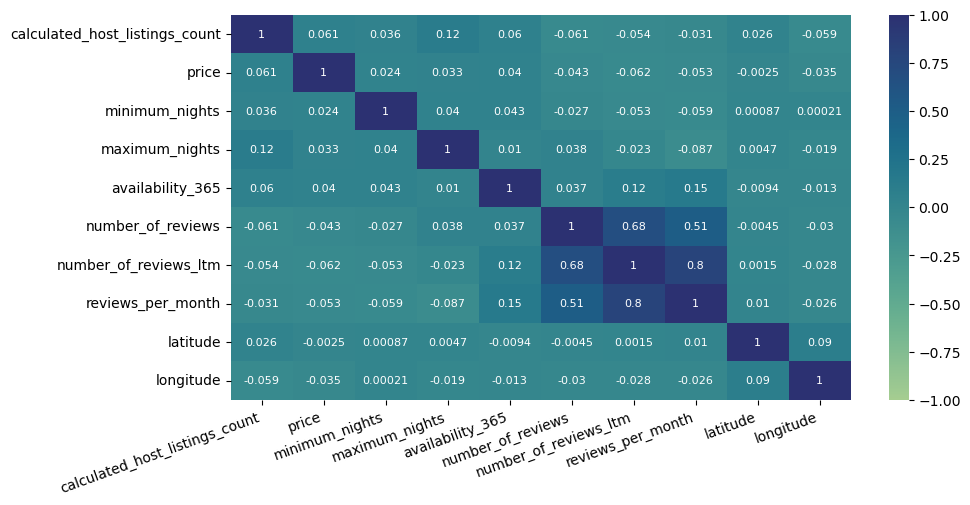

In [29]:
# Explore the correlation between variables
theVariables = [
    "calculated_host_listings_count",
    "price",
    "minimum_nights",
    "maximum_nights",
    "availability_365",
    "number_of_reviews",
    "number_of_reviews_ltm",
    "reviews_per_month",
    "latitude",
    "longitude",
]
corrVar = data[theVariables]
plt.figure(figsize=(10, 5))
coef = corrVar.corr()
sns.heatmap(coef, annot=True, annot_kws={"fontsize": 8}, cmap="crest", vmin=-1, vmax=1)
plt.xticks(rotation=20, ha="right")
plt.show()

*<u>Main Findings:</u>*
- The variables are not highly correlated with each other except reviews.
- The number of reviews the listing has in the last 12 months(`number_of_reviews_ltm`) is highly correlated with `number_of_reviews` and `reviews_per_month`.
    - In order to avoid multicollinearity, the variable `number_of_reviews_ltm` will be the only one included in the model.

In [30]:
# Estimate the minimum nights booked, the minimum price per night and the minimum income for the past 12 months
# The data will exclude listings without price information
# The number of reviews for each listing during the past 12 months is used as a factor in the analysis
estData = data.loc[
    ((data["price"].notna()) & (data["price"] != 0)),
    ["minimum_nights", "number_of_reviews_ltm", "price", "availability_365"],
]
minimum_total_nights = (
    estData["minimum_nights"] * estData["number_of_reviews_ltm"]
).sum(skipna=False)
minimum_total_income = (
    estData["minimum_nights"] * estData["number_of_reviews_ltm"] * estData["price"]
).sum(skipna=False)

minimum_nights_booked = minimum_total_nights / len(estData)
minimum_price_per_night = minimum_total_income / minimum_total_nights
minimum_income = minimum_total_income / len(estData)

print(f"minimum_nights_booked: {minimum_nights_booked:.0f}")
print(f"minimum_price_per_night:{minimum_price_per_night:.0f}")
print(f"minimum_income:{minimum_income:.0f}")
print(
    f"average available days for booking in a year:{estData['availability_365'].mean(skipna=False):.0f}"
)

minimum_nights_booked: 21
minimum_price_per_night:148
minimum_income:3172
average available days for booking in a year:187


*<u>Main Findings:</u>*
- Over the past 12 months, the average minimum nights booked was about 21 nights, with the average minimum price per night being around 148 pounds. Consequently, the average minimum income was about 3172 pounds.
- The average number of days available for booking in a year is 187. This could be due to the property being booked by guests or blocked by the host.
- The `minimum_nights` does not accurately reflect the actual stays, and the `number_of_reviews_ltm` also does not indicate the actual number of orders. Decisions relying on these metrics demand careful deliberation.

# Model estimation and prediction <a id="model"></a>

## Data preparation for modeling <a id="modeling"></a>

In [31]:
# Ensure robust estimation and prediction, it is necessary to remove missing values and handle outliers
# Prices lower than 8 pounds will be excluded
mdlData = data.loc[
    ((data["price"].notna()) & (data["price"] >= 8)),
    [
        "calculated_host_listings_count",
        "room_type",
        "minimum_nights",
        "maximum_nights",
        "availability_365",
        "number_of_reviews_ltm",
        "price",
        "latitude",
        "longitude",
    ],
]
# Create dummy variables from `room_type`
mdlData = pd.get_dummies(
    mdlData, columns=["room_type"], prefix="", prefix_sep="", dtype=int
)
mdlData.drop(["Hotel room"], axis=1, inplace=True)

In [32]:
# Functions used to detect outliers
def outliersNumber_IQR(vec):
    pct25 = vec.quantile(0.25)
    pct75 = vec.quantile(0.75)
    iqr = pct75 - pct25
    upperLimit = pct75 + 1.5 * iqr
    lowerLimit = pct25 - 1.5 * iqr
    outliersNumber = sum((vec > upperLimit) | (vec < lowerLimit))
    outlierIndex = vec[(vec > upperLimit) | (vec < lowerLimit)].index
    return outliersNumber, outlierIndex


def outliersNumber_Std(vec):
    upperLimit = vec.mean() + 3 * vec.std()
    lowerLimit = vec.mean() - 3 * vec.std()
    outliersNumber = sum((vec > upperLimit) | (vec < lowerLimit))
    outlierIndex = vec[(vec > upperLimit) | (vec < lowerLimit)].index
    return outliersNumber, outlierIndex

In [33]:
# Count the number of outliers
print("the number of outliers based on 1.5 IQR >>")
for var in mdlData.columns:
    [outliersNumber, _] = outliersNumber_IQR(mdlData[var])
    print(f"{var}: {outliersNumber}")

the number of outliers based on 1.5 IQR >>
calculated_host_listings_count: 8297
minimum_nights: 4518
maximum_nights: 0
availability_365: 0
number_of_reviews_ltm: 4606
price: 3874
latitude: 2778
longitude: 2163
Entire home/apt: 0
Private room: 0
Shared room: 293


In [34]:
# Count the number of outliers
print("the number of outliers based on 3std >>")
for var in mdlData.columns:
    [outliersNumber, _] = outliersNumber_Std(mdlData[var])
    print(f"{var}: {outliersNumber}")

the number of outliers based on 3std >>
calculated_host_listings_count: 1497
minimum_nights: 740
maximum_nights: 0
availability_365: 0
number_of_reviews_ltm: 1462
price: 271
latitude: 445
longitude: 644
Entire home/apt: 0
Private room: 0
Shared room: 293


In [35]:
# Treating important values as outliers and removing them will change the meaning of the data
# Outliers in this dataset will be identified exclusively within the `price` variable
[numIQR, idxIQR] = outliersNumber_IQR(mdlData["price"])
[numStd, idxStd] = outliersNumber_Std(mdlData["price"])
print("outliers based on 1.5 IQR threshold:")
print(mdlData.loc[idxIQR, "price"].sort_values())
print("")
print("outliers based on 3std threshold:")
print(mdlData.loc[idxStd, "price"].sort_values())
mdlDataClean = mdlData.drop(idxStd)

outliers based on 1.5 IQR threshold:
82931      390.0
85729      390.0
51646      390.0
62830      390.0
67273      390.0
          ...   
70132    12000.0
42717    20000.0
7671     25000.0
27139    50000.0
10490    53588.0
Name: price, Length: 3874, dtype: float64

outliers based on 3std threshold:
67931     1486.0
22987     1486.0
59776     1488.0
35479     1490.0
84024     1492.0
          ...   
75204    12000.0
42717    20000.0
7671     25000.0
27139    50000.0
10490    53588.0
Name: price, Length: 271, dtype: float64


*<u>Main Findings:</u>*
- When using the 1.5 IQR rule to detect outliers in `price`, any prices exceeding 389.9 will be removed. In contrast, the rule of 3 standard deviations (3std) sets the price threshold at 1486.
- Since at least 95% of the market consists of rooms priced under 500 pounds per night, the rule of 3 standard deviations will be applied for outlier detection.

In [36]:
# Summary of the cleaned data
mdlDataClean.reset_index(drop=True, inplace=True)
mdlDataClean.info()
mdlDataClean.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57610 entries, 0 to 57609
Data columns (total 11 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   calculated_host_listings_count  57610 non-null  int64  
 1   minimum_nights                  57610 non-null  int64  
 2   maximum_nights                  57610 non-null  int64  
 3   availability_365                57610 non-null  int64  
 4   number_of_reviews_ltm           57610 non-null  int64  
 5   price                           57610 non-null  float64
 6   latitude                        57610 non-null  float64
 7   longitude                       57610 non-null  float64
 8   Entire home/apt                 57610 non-null  int32  
 9   Private room                    57610 non-null  int32  
 10  Shared room                     57610 non-null  int32  
dtypes: float64(3), int32(3), int64(5)
memory usage: 4.2 MB


,calculated_host_listings_count,minimum_nights,maximum_nights,availability_365,number_of_reviews_ltm,price,latitude,longitude,Entire home/apt,Private room,Shared room
count,57610.000000,57610.00000,57610.000000,57610.000000,57610.000000,57610.000000,57610.000000,57610.000000,57610.000000,57610.000000,57610.000000
mean,17.902083,5.11899,459.362211,186.367540,7.861968,164.600660,51.509056,-0.129990,0.662125,0.330863,0.005069
std,53.520948,16.60028,405.091966,117.831492,13.563883,149.134619,0.049650,0.105326,0.472990,0.470528,0.071014
min,1.000000,1.00000,1.000000,0.000000,0.000000,8.000000,51.295937,-0.497800,0.000000,0.000000,0.000000
25%,1.000000,1.00000,90.000000,80.000000,0.000000,73.000000,51.484502,-0.192500,0.000000,0.000000,0.000000
50%,2.000000,2.00000,365.000000,180.000000,3.000000,124.000000,51.513033,-0.132971,1.000000,0.000000,0.000000
75%,10.000000,4.00000,730.000000,285.000000,10.000000,200.000000,51.537456,-0.068937,1.000000,1.000000,0.000000
max,558.000000,999.00000,1444.000000,365.000000,475.000000,1480.000000,51.681781,0.295731,1.000000,1.000000,1.000000


## Estimation <a id="linear"></a>

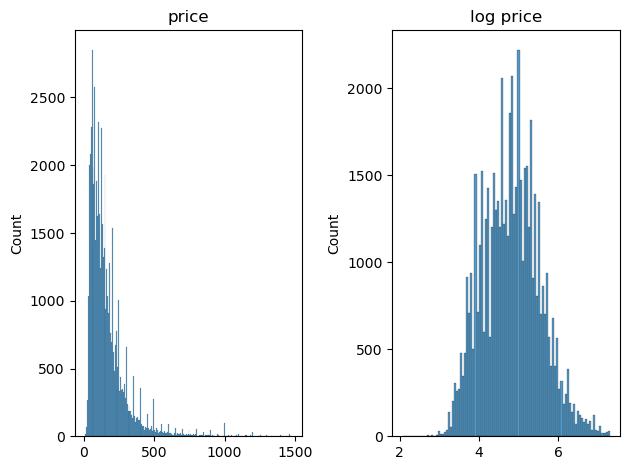

In [37]:
# Visualize dependent variable
[fig, axes] = plt.subplots(1, 2)
price = mdlDataClean["price"]
logPrice = np.log(price)
sns.histplot(ax=axes[0], data=price)
axes[0].set_title("price")
axes[0].set_xlabel("")
sns.histplot(ax=axes[1], data=logPrice)
axes[1].set_title("log price")
axes[1].set_xlabel("")
fig.tight_layout()

In [38]:
# Normalize data
X = mdlDataClean.drop(["price"], axis=1)
y = mdlDataClean["price"]
X_norm = X.copy()
X_norm.iloc[:, :-3] = (X_norm.iloc[:, :-3] - X_norm.iloc[:, :-3].mean()) / X_norm.iloc[:, :-3].std()

# Fit linear regression model
cX_norm = sm.add_constant(X_norm)
log_y = np.log(y)
lmModel = sm.OLS(log_y, cX_norm)
lmResult = lmModel.fit()
print(lmResult.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.432
Model:                            OLS   Adj. R-squared:                  0.432
Method:                 Least Squares   F-statistic:                     4379.
Date:                Wed, 10 Jul 2024   Prob (F-statistic):               0.00
Time:                        21:28:05   Log-Likelihood:                -47172.
No. Observations:               57610   AIC:                         9.437e+04
Df Residuals:                   57599   BIC:                         9.446e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const       

*<u>Main Findings:</u>*
- Only about 43% of the variation in `price` is explained by the model.
- All independent variables, except for `Entire home/apt` and `latitude`, are statistically significant at the 5% level.
- The price in `Entire home/apt` overall is not significantly different from the average price, whereas prices for `Private room` and `Shared room` are significantly lower.

## Prediction <a id="predict"></a>

In [39]:
# Split the data into training and testing sets
[X_train, X_test, y_train, y_test] = train_test_split(
    X_norm, log_y, test_size=0.3, random_state=8
)

# Get shape of each training and testing set
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((40327, 10), (17283, 10), (40327,), (17283,))

In [40]:
# Build the models 
models = [
    ("linReg", LinearRegression()),
    ("KNN", KNeighborsRegressor()),
    ("treeReg", DecisionTreeRegressor(random_state=8)),
    ("rForest", RandomForestRegressor(n_jobs=-1, random_state=8)),
    ("NN", MLPRegressor(random_state=8)),
    ("XGBoost", XGBRegressor(objective="reg:squarederror")),
]

In [41]:
# Function to evaluate models
def modelEvaluation(models, X_train=None, y_train=None, X_test=None, y_test=None):
    resultTable = {}
    predValue = {}
    
    for modelName, model in models:
        timeBeg = time.time()
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        r2 = metrics.r2_score(y_test, y_pred)
        rmse = metrics.root_mean_squared_error(y_test, y_pred)
        mae = metrics.mean_absolute_error(y_test, y_pred)
        timeDur = time.time() - timeBeg
    
        resultTable.update({modelName: [r2, rmse, mae, timeDur]})
        predValue.update({modelName: np.exp(y_pred)})
    
    resultTable = pd.DataFrame(resultTable)
    resultTable.index = ["R_squared", "RMSE", "MAE", "model_time"]
    predValue = pd.DataFrame(predValue)
    predValue["actual"] = np.exp(y_test.reset_index(drop=True))
    
    print("models performance >>")
    display(resultTable.head())
    print("")
    print("predictions overview >>")
    display(predValue.head())
    
    return resultTable, predValue

In [42]:
# Function to visualize models performance
def modelVisualization(resultTable):
    modelNames = resultTable.columns
    [fig, axes] = plt.subplots(2, 2, figsize=(10, 8))
    axes[0, 0].bar(modelNames, resultTable.loc["R_squared"])
    axes[0, 0].set_title("R_squared")
    axes[0, 1].bar(modelNames, resultTable.loc["RMSE"])
    axes[0, 1].set_title("RMSE")
    axes[1, 0].bar(modelNames, resultTable.loc["MAE"])
    axes[1, 0].set_title("MAE")
    axes[1, 1].bar(modelNames, resultTable.loc["model_time"])
    axes[1, 1].set_title("model_time")
    fig.tight_layout()

In [43]:
# Evaluate models
[resultTable, predValue] = modelEvaluation(models,X_train=X_train, y_train=y_train, X_test=X_test, y_test=y_test)

models performance >>


,linReg,KNN,treeReg,rForest,NN,XGBoost
R_squared,0.428819,0.521496,0.240494,0.621761,0.541423,0.602591
RMSE,0.548291,0.501842,0.632252,0.446177,0.491282,0.457345
MAE,0.420852,0.378400,0.459068,0.331646,0.377680,0.345998
model_time,0.043476,1.865096,0.433664,4.603305,33.483443,0.334987



predictions overview >>


,linReg,KNN,treeReg,rForest,NN,XGBoost,actual
0,176.263925,471.278492,120.0,225.966673,220.851056,242.441010,190.0
1,181.782208,109.235393,160.0,146.441860,150.120065,127.212334,88.0
2,188.819067,835.473237,1343.0,1005.958684,494.427561,733.099426,818.0
3,193.325515,162.284003,176.0,243.125413,151.078490,183.241852,186.0
4,190.426565,261.645960,257.0,171.856864,176.556480,200.912277,280.0


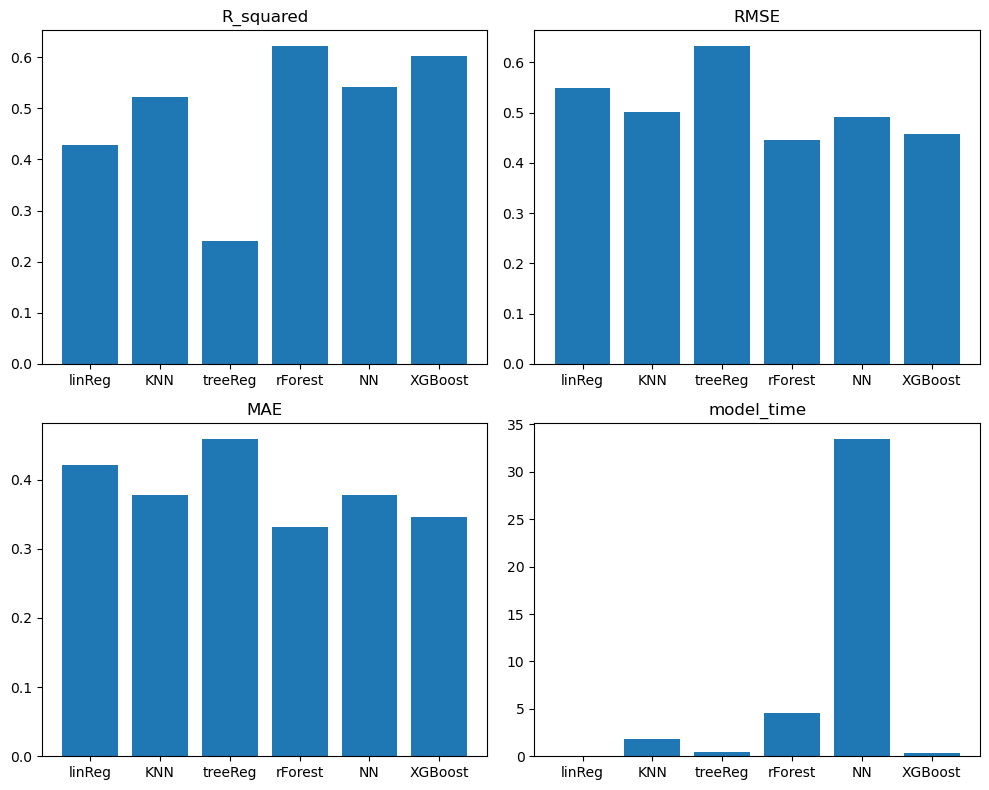

In [44]:
#  Visualize models performance
modelVisualization(resultTable)

In [45]:
# Standardize the data based on RobustScaler
scaler = RobustScaler()

X_RobustScaler = X.copy()
X_RobustScaler.iloc[:, :-3] = scaler.fit_transform(X_RobustScaler.iloc[:, :-3])

# Split the data into training and testing sets
[X_train2, X_test2, y_train2, y_test2] = train_test_split(
    X_RobustScaler, log_y, test_size=0.3, random_state=8
)

# Get shape of each training and testing set
X_train2.shape, X_test2.shape, y_train2.shape, y_test2.shape

((40327, 10), (17283, 10), (40327,), (17283,))

models performance >>


,linReg,KNN,treeReg,rForest,NN,XGBoost
R_squared,0.428819,0.524314,0.240472,0.621523,0.524427,0.602591
RMSE,0.548291,0.500362,0.632261,0.446318,0.500303,0.457345
MAE,0.420852,0.375185,0.459035,0.331739,0.387880,0.345998
model_time,0.017076,1.041927,0.386999,4.273219,18.431143,0.297456



predictions overview >>


,linReg,KNN,treeReg,rForest,NN,XGBoost,actual
0,176.263925,296.671976,120.0,222.680089,237.307924,242.441010,190.0
1,181.782208,91.504413,160.0,148.557711,156.914056,127.212334,88.0
2,188.819067,886.840392,1343.0,1003.907071,527.451897,733.099426,818.0
3,193.325515,281.182318,176.0,243.319430,145.773286,183.241852,186.0
4,190.426565,268.727692,257.0,170.414419,200.283560,200.912277,280.0


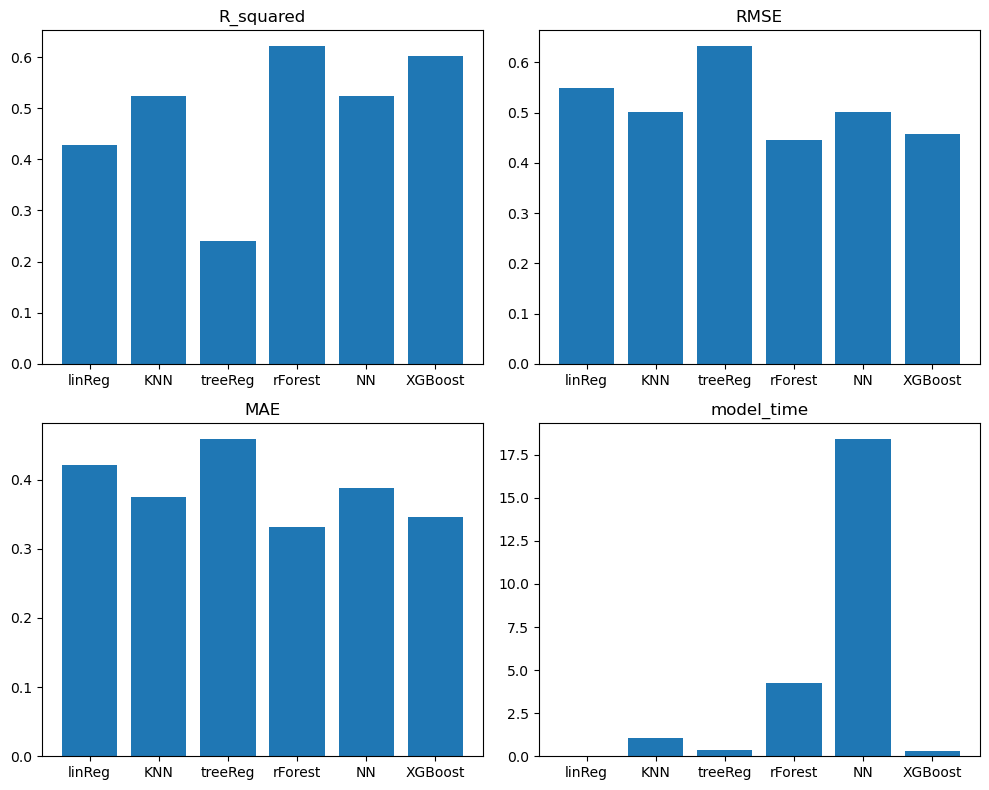

In [46]:
# Evaluate models and visualize models performance
[resultTable, predValue] = modelEvaluation(models,X_train=X_train2, y_train=y_train2, X_test=X_test2, y_test=y_test2)
modelVisualization(resultTable)

*<u>Main Findings:<u/>*
- The best model is the Random Forest.
- Standardization of the data does not appear to enhance the model's predictive performance.

## Hyperparameter tuning <a id="hypter"></a>

In [47]:
# Build models
modelsHyper = [
    ("elasticNet", ElasticNet()),
    ("KNN", KNeighborsRegressor()),
    ("treeReg", DecisionTreeRegressor(random_state=8)),
    ("rForest", RandomForestRegressor(n_jobs=-1, random_state=8)),
    ("NN", MLPRegressor(random_state=8)),
    ("XGBoost", XGBRegressor(objective="reg:squarederror")),
]

In [48]:
# Create a dictionary of hyperparameters to tune for each model
modelParam = {
    "elasticNet": {
        'alpha': [0, 0.5, 1, 2, 3], 
        'l1_ratio': [0, 0.25, 0.5, 0.75, 1]
    },
    "KNN": {
        "n_neighbors": [3, 5, 7], 
        "weights": ["uniform", "distance"]
    },
    "treeReg": {
        "max_depth": [10, None], 
        "min_samples_leaf": [1, 2, 3, 4, 5]
    },
    "rForest": {
        "max_features": [3, 4, 5],
        "n_estimators": [100, 130, 160],
        "min_samples_split": [2, 3, 4],
    },
    "NN": {
        "hidden_layer_sizes": [(100,), (50, 25)],
        "activation": ["identity", "logistic", "tanh", "relu"],
        "solver": ["lbfgs", "sgd", "adam"],
        "max_iter": [500],
    },
    "XGBoost": {
        "min_child_weight": [1, 2, 3, 4, 5],
        "learning_rate": [0.01, 0.05, 0.1, 0.2, 0.3],
        "n_estimators": [100, 300, 500],
    },
}

# Assign a set of scoring metrics to capture
scoring = ["r2", "neg_root_mean_squared_error", "neg_mean_absolute_error"]

# Examine the best model from GridSearchCV
modelObjects = {}
for modelName, model in modelsHyper:
    timeBeg = time.time()
    theSearch = GridSearchCV(
        model, modelParam[modelName], scoring=scoring, cv=5, refit="r2", n_jobs=-1
    )
    modelObjects[modelName] = theSearch.fit(X_train, y_train)
    timeDur = time.time() - timeBeg
    modelObjects[modelName + "Time"] = timeDur

In [49]:
# Function to extract scores from the GridSearchCV fit object
def estimationResult(modelObjects):
    theBestEstimators = {}
    theBestParameters = {}
    estimationCompare = {}
    modelNames = [v for v in modelObjects.keys() if not all(s in v for s in 'Time')]
    for modelName in modelNames:
        cv_results = pd.DataFrame(modelObjects[modelName].cv_results_)
        best_estimator_results = cv_results.iloc[cv_results['mean_test_r2'].idxmax(), :]
        r2 = best_estimator_results.mean_test_r2
        negRMSE = best_estimator_results.mean_test_neg_root_mean_squared_error
        negMAE = best_estimator_results.mean_test_neg_mean_absolute_error
        timeDur = modelObjects[modelName+'Time']     
        estimationCompare.update({modelName: [r2, negRMSE, negMAE, timeDur]})
        
        theBestEstimators[modelName] = modelObjects[modelName].best_estimator_
        theBestParameters[modelName] = modelObjects[modelName].best_params_

    estimationCompare = pd.DataFrame(estimationCompare)
    estimationCompare.index = ["R_squared", "negtiveRMSE", "negativeMAE", "model_time"]

    return theBestEstimators, theBestParameters, estimationCompare

In [50]:
# Call the function on our models
[theBestEstimators, theBestParameters, estimationCompare] = estimationResult(modelObjects)
print('The best parameters: >> \n')
display(theBestParameters)
print("")
print('The best parameters performance: >> \n')
display(estimationCompare)

The best parameters: >> 



{'elasticNet': {'alpha': 0, 'l1_ratio': 0},
 'KNN': {'n_neighbors': 7, 'weights': 'distance'},
 'treeReg': {'max_depth': 10, 'min_samples_leaf': 5},
 'rForest': {'max_features': 4, 'min_samples_split': 2, 'n_estimators': 160},
 'NN': {'activation': 'relu',
  'hidden_layer_sizes': (50, 25),
  'max_iter': 500,
  'solver': 'lbfgs'},
 'XGBoost': {'learning_rate': 0.1, 'min_child_weight': 2, 'n_estimators': 500}}


The best parameters performance: >> 



,elasticNet,KNN,treeReg,rForest,NN,XGBoost
R_squared,0.432450,0.548519,0.529886,0.631726,0.568520,0.617485
negtiveRMSE,-0.549280,-0.489909,-0.499901,-0.442473,-0.478939,-0.450943
negativeMAE,-0.423531,-0.370049,-0.381326,-0.331704,-0.366401,-0.341874
model_time,6.907512,5.705644,2.125764,246.322631,189.357964,25.794870


# Model selection and final results <a id="result"></a>

In [51]:
# Predict on test data
resultTable = {}
predValue = {}

for modelName , _ in modelsHyper:
    y_pred = theBestEstimators[modelName].predict(X_test)
    r2 = metrics.r2_score(y_test, y_pred)
    rmse = metrics.root_mean_squared_error(y_test, y_pred)
    mae = metrics.mean_absolute_error(y_test, y_pred)
    
    resultTable.update({modelName: [r2, rmse, mae]})
    predValue.update({modelName: np.exp(y_pred)})

resultTable = pd.DataFrame(resultTable)
resultTable.index = ["R_squared", "RMSE", "MAE"]
predValue = pd.DataFrame(predValue)
predValue["actual"] = np.exp(y_test.reset_index(drop=True))

print("models performance >>")
display(resultTable.head())
print("")
print("predictions overview >>")
display(predValue.head())

models performance >>


,elasticNet,KNN,treeReg,rForest,NN,XGBoost
R_squared,0.428820,0.550777,0.527026,0.628726,0.559714,0.612262
RMSE,0.548291,0.486245,0.498934,0.442050,0.481384,0.451745
MAE,0.420852,0.364293,0.378543,0.328440,0.366579,0.340195



predictions overview >>


,elasticNet,KNN,treeReg,rForest,NN,XGBoost,actual
0,176.264028,313.077243,222.535772,201.265830,192.295302,233.499146,190.0
1,181.782357,117.195900,113.188846,140.684069,136.470340,112.258232,88.0
2,188.819486,920.540303,1095.451614,897.484376,770.094697,901.483215,818.0
3,193.325770,175.954067,195.419574,200.370328,139.246285,203.780167,186.0
4,190.426720,222.341856,145.279208,210.457666,236.723871,187.182465,280.0


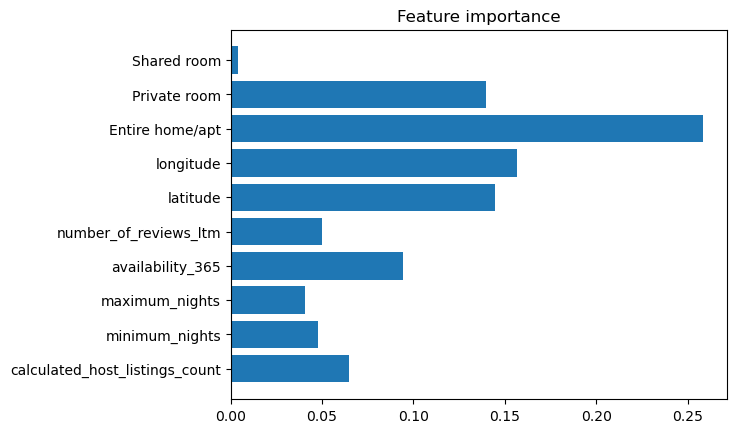

In [52]:
# Feature importance of the best model
impt = theBestEstimators["rForest"].feature_importances_
plt.barh(X_test.columns,impt)
plt.title('Feature importance')
plt.show()

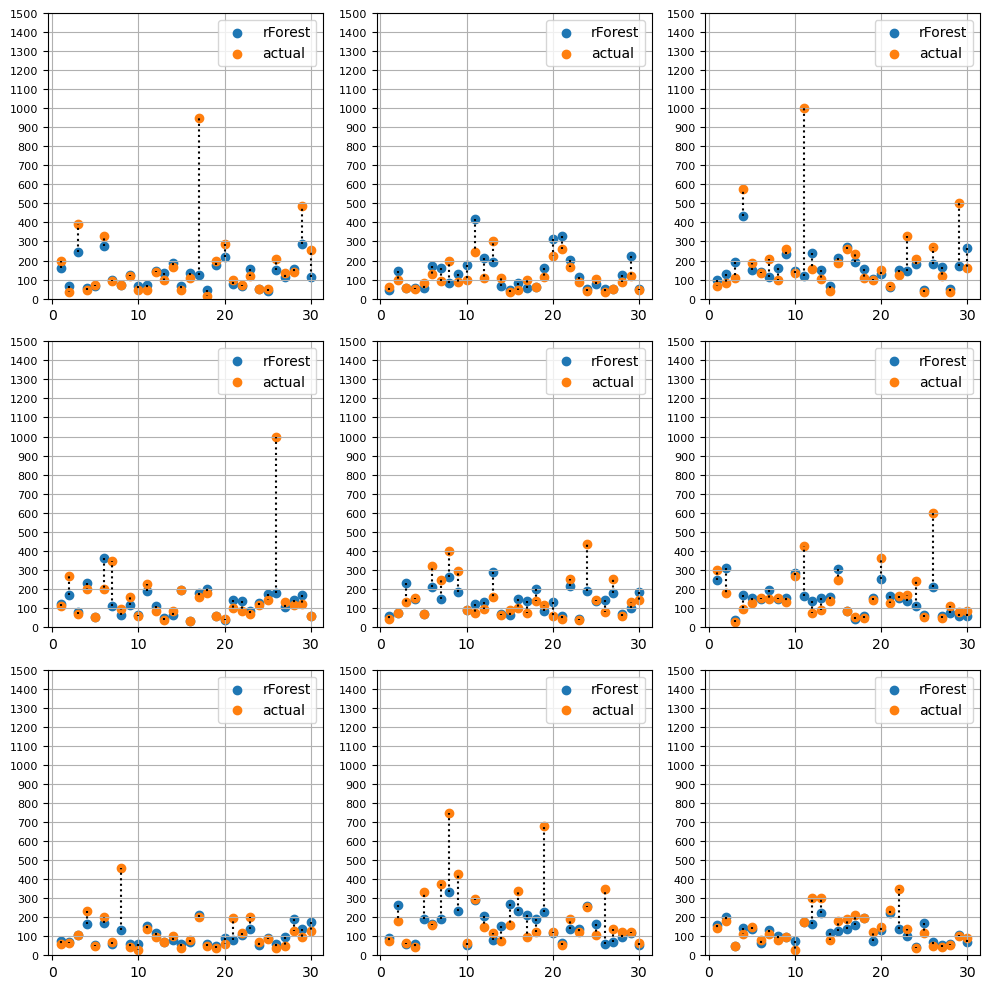

In [53]:
# Predicted values from the best model vs actual values
# Randomly select 30 points to view the differences between predicted and actual values
[fig, axes] = plt.subplots(3, 3, figsize=(10,10))
for ax in axes.flat:
    randVal = np.random.choice(predValue.index, 30)
    x = np.arange(1, 31)
    yF = predValue["rForest"][randVal]
    yA = predValue["actual"][randVal]
    ax.scatter(x, yF)
    ax.scatter(x, yA)
    ax.plot((x,x),(yF, yA),"k:")
    ax.set_ylim(0,1500)
    plt.sca(ax)                                  
    plt.yticks(np.arange(0,1501,100),fontsize=8)
    ax.legend(["rForest", "actual"])
    ax.grid()
fig.tight_layout()

*<u>Main Findings:</u>*
- The best model for price prediction is the Random Forest.
- The model explains about 63% of the variation in price.